In [1]:
import kabuki
import os
import hddm
import matplotlib.pyplot as plt
import pickle
from joblib import Parallel,delayed
from glob import glob
from kabuki.analyze import gelman_rubin
import arviz
import numpy as np
from patsy import dmatrix 


from sklearn.preprocessing import StandardScaler


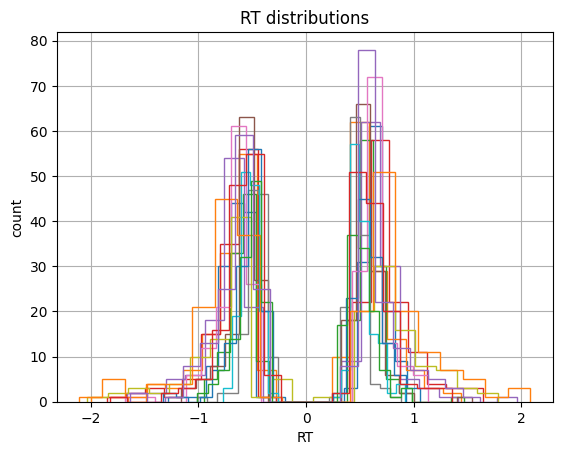

In [2]:



data = hddm.load_csv('./data.csv')
data['rt']=data['rt']+0.2
data['response']=data['_response']

df = data

df = hddm.utils.flip_errors(df)


df['cpp_slope']=StandardScaler().fit_transform(df['cpp_slope'].to_numpy().reshape(-1,1))

df['cpp_amplitude']=StandardScaler().fit_transform(df['cpp_amplitude'].to_numpy().reshape(-1,1))

df['cpp_peak']=StandardScaler().fit_transform(df['cpp_peak'].to_numpy().reshape(-1,1))



def z_link_func(x, data=df):
    
    return 1 / (1 + np.exp(-x.to_frame()))


fig = plt.figure()

ax = fig.add_subplot(111, xlabel='RT', ylabel='count', title='RT distributions')

for i, subj_data in df.groupby('subj_idx'):

    subj_data.rt.hist(bins=20, histtype='step', ax=ax)


In [14]:


# m0: Basic ddm without other parameters
def run_m0(id, df=None, samples=None, burn=None, thin=1,save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 
    
    mname  = save_name + '_chain_%i'%id    

    m = hddm.HDDM(df)
    
    #m.find_starting_values()
    
    m.sample(samples, burn=burn, thin=thin,dbname=dbname, db='pickle')
    
    m.save(mname)
    
    return m

m0 = Parallel(n_jobs = 8)(delayed(run_m0)(id = i, df = df, samples=10000,burn = 2000,thin=5, save_name = '2_4_2_2_temp/m0' ) for i in range(8))


# m1: Basic ddm with parameters [z]
def run_m1(id, df=None, samples=None, burn=None, thin = 1,save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 
    
    mname  = save_name + '_chain_%i'%id    

    m = hddm.HDDM(df,include=['z'])
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m1 = Parallel(n_jobs = 8)(delayed(run_m1)(id = i, df = df, samples=10000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m1' ) for i in range(8))


[                  0%                  ] 14 of 4000 complete in 0.5 sec
[                  0%                  ] 12 of 4000 complete in 0.5 sec
[                  0%                  ] 12 of 4000 complete in 0.5 sec
[                  0%                  ] 14 of 4000 complete in 0.5 sec
[                  0%                  ] 14 of 4000 complete in 0.5 sec
[                  0%                  ] 6 of 4000 complete in 0.5 sec
[                  0%                  ] 14 of 4000 complete in 0.5 sec
[                  0%                  ] 32 of 4000 complete in 1.0 sec
[                  0%                  ] 28 of 4000 complete in 1.0 sec
[                  0%                  ] 28 of 4000 complete in 1.0 sec
[                  0%                  ] 31 of 4000 complete in 1.0 sec
[                  0%                  ] 30 of 4000 complete in 1.0 sec
[                  0%                  ] 20 of 4000 complete in 1.1 sec
[                  0%                  ] 8 of 4000 complete in 0.

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 15 of 4000 complete in 0.5 sec
[                  0%                  ] 16 of 4000 complete in 0.5 sec
[                  0%                  ] 15 of 4000 complete in 0.5 sec
[                  0%                  ] 15 of 4000 complete in 0.5 sec
[                  0%                  ] 14 of 4000 complete in 0.5 sec
[                  0%                  ] 14 of 4000 complete in 0.5 sec
[                  0%                  ] 13 of 4000 complete in 0.5 sec
[                  0%                  ] 13 of 4000 complete in 0.5 sec
[                  0%                  ] 26 of 4000 complete in 1.0 sec
[                  0%                  ] 27 of 4000 complete in 1.0 sec
[                  0%                  ] 26 of 4000 complete in 1.0 sec
[                  0%                  ] 27 of 4000 complete in 1.0 sec
[                  0%                  ] 24 of 4000 complete in 1.0 sec
[                  0%                  ] 26 of 4000 complete in 

In [13]:

# m3: HDDMRegressor: v ~ C(coherency, Treatment('low')), with ['z','st','sv','sz']
def run_m3(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    m = hddm.HDDMRegressor(df,"v ~ C(coherency, Treatment('low'))" ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m3 = Parallel(n_jobs = 8)(delayed(run_m3)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m3' ) for i in range(8))








Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]


/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 3 of 4000 complete in 0.6 sec
[                  0%                  ] 3 of 4000 complete in 0.5 sec
[                  0%                  ] 3 of 4000 complete in 0.6 sec
[                  0%                  ] 3 of 4000 complete in 0.6 sec
[                  0%                  ] 3 of 4000 complete in 0.5 sec
[                  0%                  ] 3 of 4000 complete in 0.6 sec
[                  0%                  ] 6 of 4000 complete in 1.2 sec
[                  0%                  ] 6 of 4000 complete in 1.2 sec
[                  0%                  ] 6 of 4000 complete in 1.3 sec
[                  0%                  ] 6 of 4000 complete in 1.3 sec
[                  0%                  ] 6 of 4000 complete in 1.2 sec
[                  0%                  ] 6 of 4000 complete in 1.3 sec
[                  0%                  ] 3 of 4000 complete in 0.6 sec
[                  0%                  ] 9 of 4000 complete in 1.8 sec
[     

In [4]:
# m: HDDMRegressor: v ~ 1 + C(coherency, Treatment('low')), z~1+C(prioritization, Treatment('no')), with ['z','st','sv','sz']

def run_m4(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    
    v_reg={'model': "v~1+C(coherency, Treatment('low'))", 'link_func': lambda x:x}
    
    z_reg={'model': "z~1+C(prioritization, Treatment('no'))", 'link_func': z_link_func}

    m = hddm.HDDMRegressor(df, [v_reg, z_reg] ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m4 = Parallel(n_jobs = 8)(delayed(run_m4)(id = i, df = df, samples=8000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m4' ) for i in range(8))




Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prio

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 2 of 8000 complete in 0.7 sec
[                  0%                  ] 2 of 8000 complete in 0.8 sec
[                  0%                  ] 2 of 8000 complete in 0.8 sec
[                  0%                  ] 2 of 8000 complete in 0.8 sec
[                  0%                  ] 3 of 8000 complete in 1.6 sec
[                  0%                  ] 2 of 8000 complete in 0.8 sec
[                  0%                  ] 2 of 8000 complete in 0.8 sec
[                  0%                  ] 2 of 8000 complete in 1.3 sec
[                  0%                  ] 3 of 8000 complete in 1.6 sec
[                  0%                  ] 4 of 8000 complete in 2.3 sec
[                  0%                  ] 3 of 8000 complete in 1.7 sec
[                  0%                  ] 3 of 8000 complete in 1.6 sec
[                  0%                  ] 3 of 8000 complete in 1.7 sec
[                  0%                  ] 3 of 8000 complete in 1.6 sec
[     

In [8]:


# m: HDDMRegressor: v ~ 1 + C(coherency, Treatment('low')), t ~ 1 + C(prioritization, Treatment('no')), with ['z','st','sv','sz']
def run_m5(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    
    v_reg={'model': "v~1+C(coherency, Treatment('low'))", 'link_func': lambda x:x}
    
    t_reg={'model': "t~1+C(prioritization, Treatment('no'))", 'link_func': lambda x:x}

    m = hddm.HDDMRegressor(df, [v_reg, t_reg] ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m5 = Parallel(n_jobs = 8)(delayed(run_m5)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m5' ) for i in range(8))



Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prio

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 2 of 4000 complete in 0.5 sec
[                  0%                  ] 2 of 4000 complete in 0.5 sec
[                  0%                  ] 2 of 4000 complete in 0.5 sec
[                  0%                  ] 2 of 4000 complete in 0.5 sec
[                  0%                  ] 4 of 4000 complete in 1.4 sec
[                  0%                  ] 3 of 4000 complete in 0.9 sec
[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 3 of 4000 complete in 1.1 sec
[                  0%                  ] 3 of 4000 complete in 1.1 sec
[                  0%                  ] 3 of 4000 complete in 1.2 sec
[                  0%                  ] 3 of 4000 complete in 1.1 sec
[                  0%                  ] 6 of 4000 complete in 2.2 sec
[                  0%                  ] 2 of 4000 complete in 0.7 sec
[                  0%                  ] 5 of 4000 complete in 1.8 sec
[     

In [4]:

## joint modeling

# m: HDDMRegressor: v ~ 1 + C(coherency, Treatment('low')), t ~ 1 + C(prioritization, Treatment('no')), with ['z','st','sv','sz']
def run_m6(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    v_reg={'model': "v~1+C(coherency, Treatment('low'))+cpp_slope+cpp_slope:C(coherency, Treatment('low'))", 'link_func': lambda x: x}
    
    t_reg={'model': "t~1+C(prioritization, Treatment('no'))", 'link_func':  lambda x: x}
    
    m=hddm.HDDMRegressor(df ,[v_reg, t_reg] ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)  
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m6 = Parallel(n_jobs = 8)(delayed(run_m6)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m6' ) for i in range(8))


Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_slope', "v_cpp_slope:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_slope', "v_cpp_slope:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['t_Intercept', "t_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_slope', "v_cpp_slope:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_slope', "v_cpp_slope:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_slope', "v_cpp_slope:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['t_Intercept', "t_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherenc

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 2 of 4000 complete in 0.5 sec
[                  0%                  ] 2 of 4000 complete in 0.7 sec
[                  0%                  ] 2 of 4000 complete in 0.5 sec
[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 2 of 4000 complete in 0.5 sec
[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 3 of 4000 complete in 1.2 sec
[                  0%                  ] 3 of 4000 complete in 1.2 sec
[                  0%                  ] 3 of 4000 complete in 1.1 sec
[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 3 of 4000 complete in 1.2 sec
[                  0%                  ] 3 of 4000 complete in 1.3 sec
[                  0%                  ] 4 of 4000 complete in 1.7 sec
[     

In [3]:
def run_m6_z(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    v_reg={'model': "v~1+C(coherency, Treatment('low'))+cpp_slope+cpp_slope:C(coherency, Treatment('low'))", 'link_func': lambda x: x}
    
    z_reg={'model': "z~1+C(prioritization, Treatment('no'))", 'link_func':  z_link_func}
    
    m=hddm.HDDMRegressor(df ,[v_reg, z_reg] ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)  
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m6_z = Parallel(n_jobs = 8)(delayed(run_m6_z)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m6_z' ) for i in range(8))

Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_slope', "v_cpp_slope:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_slope', "v_cpp_slope:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_slope', "v_cpp_slope:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_slope', "v_cpp_slope:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Int

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 2 of 4000 complete in 0.8 sec
[                  0%                  ] 2 of 4000 complete in 0.9 sec
[                  0%                  ] 2 of 4000 complete in 1.0 sec
[                  0%                  ] 2 of 4000 complete in 1.2 sec
[                  0%                  ] 2 of 4000 complete in 1.0 sec
[                  0%                  ] 2 of 4000 complete in 0.8 sec
[                  0%                  ] 3 of 4000 complete in 2.1 sec
[                  0%                  ] 3 of 4000 complete in 2.0 sec
[                  0%                  ] 3 of 4000 complete in 1.9 sec
[                  0%                  ] 3 of 4000 complete in 2.1 sec
[                  0%                  ] 3 of 4000 complete in 1.9 sec
[                  0%                  ] 3 of 4000 complete in 2.6 sec
[                  0%                  ] 4 of 4000 complete in 3.4 sec
[                  0%                  ] 2 of 4000 complete in 1.1 sec
[     

In [6]:


# m: HDDMRegressor: v ~ 1 + C(coherency, Treatment('low')), t ~ 1 + C(prioritization, Treatment('no')), with ['z','st','sv','sz']
def run_m7(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    v_reg={'model': "v~1+C(coherency, Treatment('low'))+cpp_amplitude+cpp_amplitude:C(coherency, Treatment('low'))", 'link_func': lambda x: x}
    
    t_reg={'model': "t~1+C(prioritization, Treatment('no'))", 'link_func':  lambda x: x}
    
    m=hddm.HDDMRegressor(df ,[v_reg, t_reg] ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)  
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m7 = Parallel(n_jobs = 8)(delayed(run_m7)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m7' ) for i in range(8))



Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_amplitude', "v_cpp_amplitude:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['t_Intercept', "t_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_amplitude', "v_cpp_amplitude:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['t_Intercept', "t_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_amplitude', "v_cpp_amplitude:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['t_Intercept', "t_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_amplitude', "v_cpp_amplitude:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 2 of 4000 complete in 0.5 sec
[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 2 of 4000 complete in 0.7 sec
[                  0%                  ] 2 of 4000 complete in 0.9 sec
[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 2 of 4000 complete in 0.9 sec
[                  0%                  ] 3 of 4000 complete in 1.3 sec
[                  0%                  ] 3 of 4000 complete in 1.2 sec
[                  0%                  ] 2 of 4000 complete in 0.8 sec
[                  0%                  ] 3 of 4000 complete in 1.3 sec
[                  0%                  ] 3 of 4000 complete in 1.3 sec
[                  0%                  ] 3 of 4000 complete in 1.3 sec
[                  0%                  ] 4 of 4000 complete in 2.0 sec
[     

In [4]:

# m: HDDMRegressor: v ~ 1 + C(coherency, Treatment('low')), t ~ 1 + C(prioritization, Treatment('no')), with ['z','st','sv','sz']
def run_m7_z(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    v_reg={'model': "v~1+C(coherency, Treatment('low'))+cpp_amplitude+cpp_amplitude:C(coherency, Treatment('low'))", 'link_func': lambda x: x}
    
    z_reg={'model': "z~1+C(prioritization, Treatment('no'))", 'link_func':  z_link_func}
    
    m=hddm.HDDMRegressor(df ,[v_reg, z_reg] ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)  
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m7_z = Parallel(n_jobs = 8)(delayed(run_m7_z)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m7_z' ) for i in range(8))

Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_amplitude', "v_cpp_amplitude:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_amplitude', "v_cpp_amplitude:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_amplitude', "v_cpp_amplitude:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:Adding these covariates:

['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_amplitude', "v_cpp_amplitude:C(coherency, Treatment('low'))[T.high]"]['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_c

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 2 of 4000 complete in 0.9 sec
[                  0%                  ] 2 of 4000 complete in 1.1 sec
[                  0%                  ] 3 of 4000 complete in 1.9 sec
[                  0%                  ] 2 of 4000 complete in 1.0 sec
[                  0%                  ] 2 of 4000 complete in 1.2 sec
[                  0%                  ] 3 of 4000 complete in 2.2 sec
[                  0%                  ] 4 of 4000 complete in 2.9 sec
[                  0%                  ] 3 of 4000 complete in 1.9 sec
[                  0%                  ] 3 of 4000 complete in 2.2 sec
[                  0%                  ] 4 of 4000 complete in 3.1 sec
[                  0%                  ] 2 of 4000 complete in 1.0 sec
[                  0%                  ] 5 of 4000 complete in 3.8 sec
[                  0%                  ] 4 of 4000 complete in 2.9 sec
[                  0%                  ] 4 of 4000 complete in 3.2 sec
[     

In [5]:


# m: HDDMRegressor: v ~ 1 + C(coherency, Treatment('low')), t ~ 1 + C(prioritization, Treatment('no')), with ['z','st','sv','sz']
def run_m8(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    v_reg={'model': "v~1+C(coherency, Treatment('low'))+cpp_peak+cpp_peak:C(coherency, Treatment('low'))", 'link_func': lambda x: x}
    
    t_reg={'model': "t~1+C(prioritization, Treatment('no'))", 'link_func':  lambda x: x}
    
    m=hddm.HDDMRegressor(df ,[v_reg, t_reg] ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)  
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m8 = Parallel(n_jobs = 8)(delayed(run_m8)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m8' ) for i in range(8))


Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_peak', "v_cpp_peak:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_peak', "v_cpp_peak:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_peak', "v_cpp_peak:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_peak', "v_cpp_peak:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_peak', "v_cpp_peak:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_peak', "v_cpp_peak:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

KeyboardInterrupt: 

In [6]:


# m: HDDMRegressor: v ~ 1 + C(coherency, Treatment('low')), t ~ 1 + C(prioritization, Treatment('no')), with ['z','st','sv','sz']
def run_m8_z(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    v_reg={'model': "v~1+C(coherency, Treatment('low'))+cpp_peak+cpp_peak:C(coherency, Treatment('low'))", 'link_func': lambda x: x}
    
    z_reg={'model': "z~1+C(prioritization, Treatment('no'))", 'link_func':  z_link_func}
    
    m=hddm.HDDMRegressor(df ,[v_reg, z_reg] ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)  
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m8_z = Parallel(n_jobs = 8)(delayed(run_m8_z)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m8_z' ) for i in range(8))

Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_peak', "v_cpp_peak:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_peak', "v_cpp_peak:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_peak', "v_cpp_peak:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]", 'v_cpp_peak', "v_cpp_peak:C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept',

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 2 of 4000 complete in 0.9 sec
[                  0%                  ] 2 of 4000 complete in 1.1 sec
[                  0%                  ] 2 of 4000 complete in 1.2 sec
[                  0%                  ] 2 of 4000 complete in 0.9 sec
[                  0%                  ] 3 of 4000 complete in 2.0 sec
[                  0%                  ] 3 of 4000 complete in 2.0 sec
[                  0%                  ] 2 of 4000 complete in 1.1 sec
[                  0%                  ] 3 of 4000 complete in 2.2 sec
[                  0%                  ] 3 of 4000 complete in 1.9 sec
[                  0%                  ] 2 of 4000 complete in 1.1 sec
[                  0%                  ] 4 of 4000 complete in 2.9 sec
[                  0%                  ] 4 of 4000 complete in 2.9 sec
[                  0%                  ] 3 of 4000 complete in 2.1 sec
[                  0%                  ] 4 of 4000 complete in 3.2 sec
[     

In [30]:
def run_m4_x(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    
    v_reg={'model': "v~1+C(coherency, Treatment('low'))", 'link_func': lambda x:x}
    
    z_reg={'model': "z~1+C(prioritization, Treatment('no'))", 'link_func': lambda x:x}

    m = hddm.HDDMRegressor(df, [v_reg, z_reg] ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m4_x = Parallel(n_jobs = 8)(delayed(run_m4_x)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m4_x' ) for i in range(8))


Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['z_Intercept', "z_C(prioritiza

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 2 of 4000 complete in 0.8 sec
[                  0%                  ] 2 of 4000 complete in 0.7 sec
[                  0%                  ] 3 of 4000 complete in 1.1 sec
[                  0%                  ] 2 of 4000 complete in 0.8 sec
[                  0%                  ] 2 of 4000 complete in 1.0 sec
[                  0%                  ] 3 of 4000 complete in 1.3 sec
[                  0%                  ] 3 of 4000 complete in 1.4 sec
[                  0%                  ] 3 of 4000 complete in 1.6 sec
[                  0%                  ] 3 of 4000 complete in 1.3 sec
[                  0%                  ] 4 of 4000 complete in 1.7 sec
[                  0%                  ] 2 of 4000 complete in 0.5 sec
[     

{'a': 1.0013954556469216, 'a_std': 1.0000404851945297, 'a_subj.1': 1.0003109017055412, 'a_subj.3': 0.999994274023644, 'a_subj.5': 1.0076723505470842, 'a_subj.6': 1.0002305335506878, 'a_subj.7': 0.9999647729419906, 'a_subj.8': 1.002093932350401, 'a_subj.9': 1.0139180594434192, 'a_subj.10': 1.00285000167695, 'a_subj.11': 1.0007956808485614, 'a_subj.12': 0.9994230763763674, 'a_subj.13': 1.0005568086108318, 'a_subj.14': 1.0017335519193822, 'a_subj.15': 0.9999037840789008, 'a_subj.16': 1.0007634240132939, 'a_subj.17': 1.0015314182568296, 't': 0.9992338612104863, 't_std': 1.000111280593623, 't_subj.1': 0.9993819084886623, 't_subj.3': 1.0004129691841745, 't_subj.5': 1.0083255950019796, 't_subj.6': 0.9997104607706286, 't_subj.7': 0.9995758516372911, 't_subj.8': 1.0021978565197394, 't_subj.9': 1.0351639123106313, 't_subj.10': 1.007357319759523, 't_subj.11': 1.0029390416052721, 't_subj.12': 0.9999176157000538, 't_subj.13': 1.001123206795201, 't_subj.14': 1.0003220033876692, 't_subj.15': 1.000213

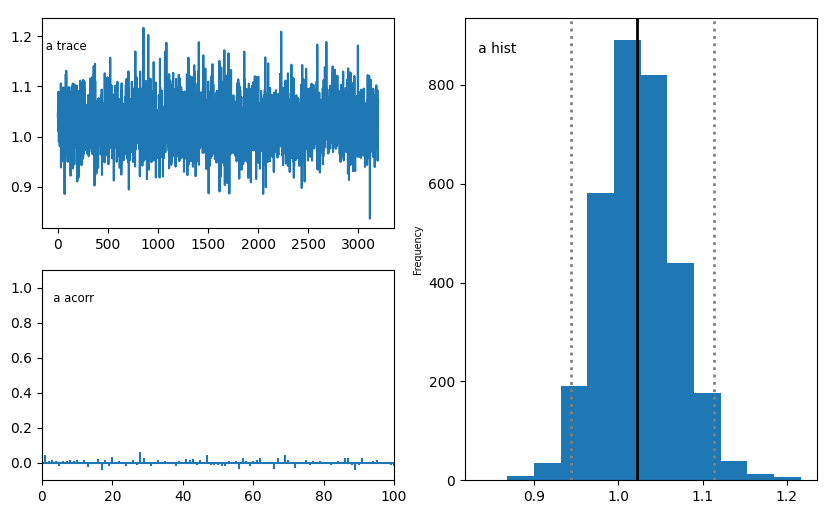

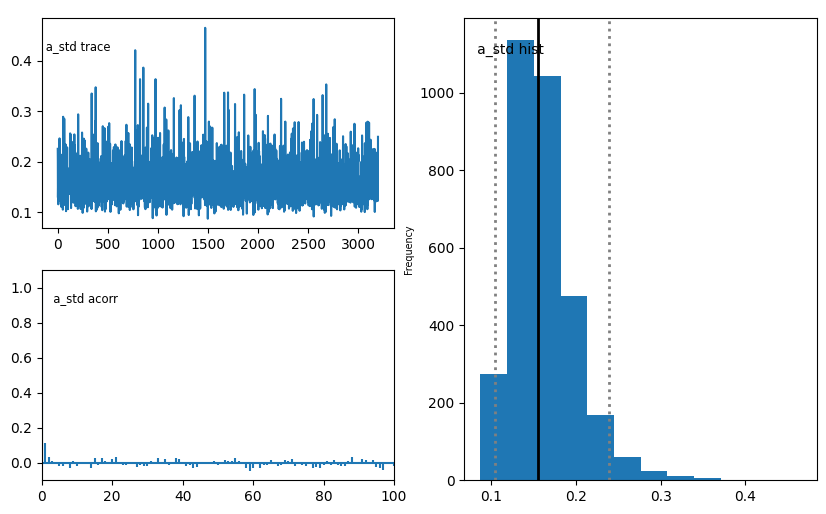

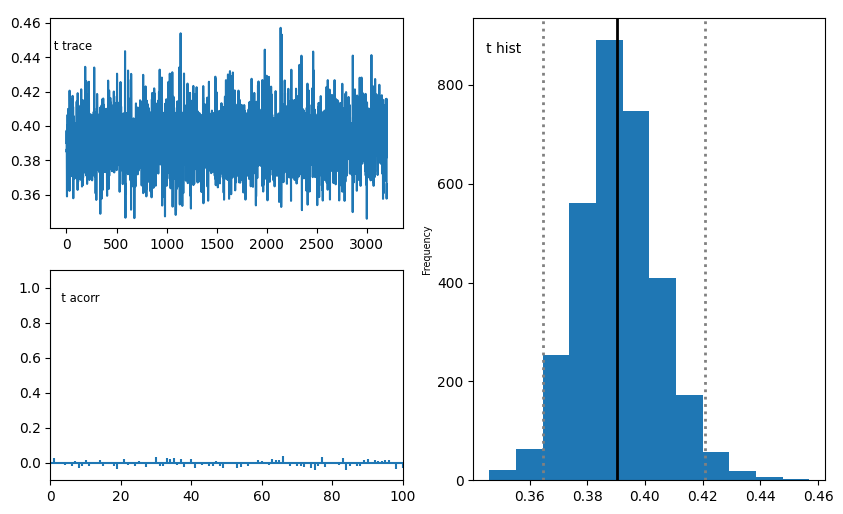

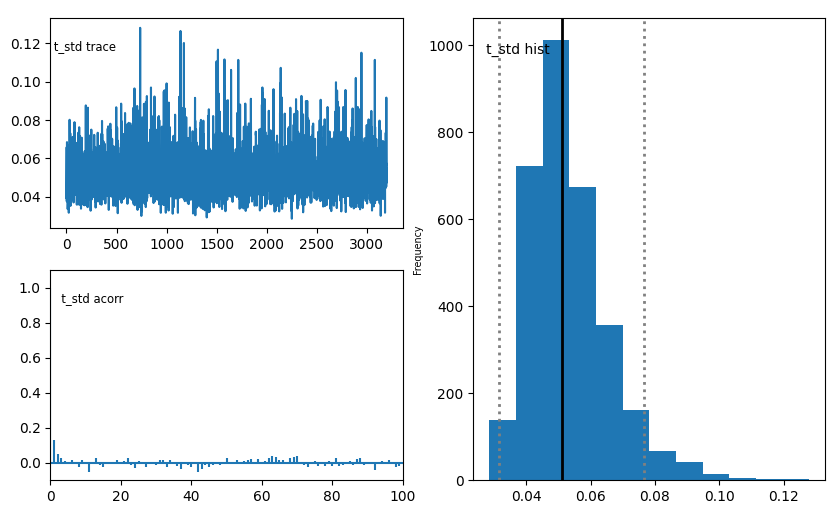

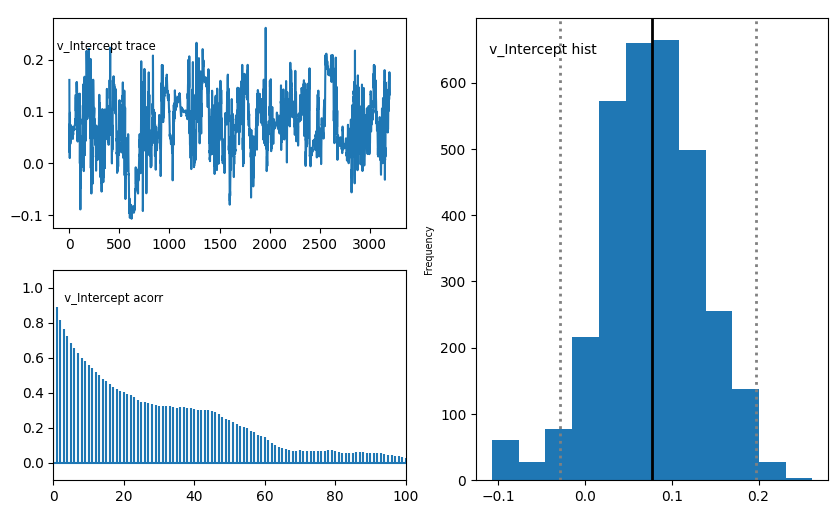

...

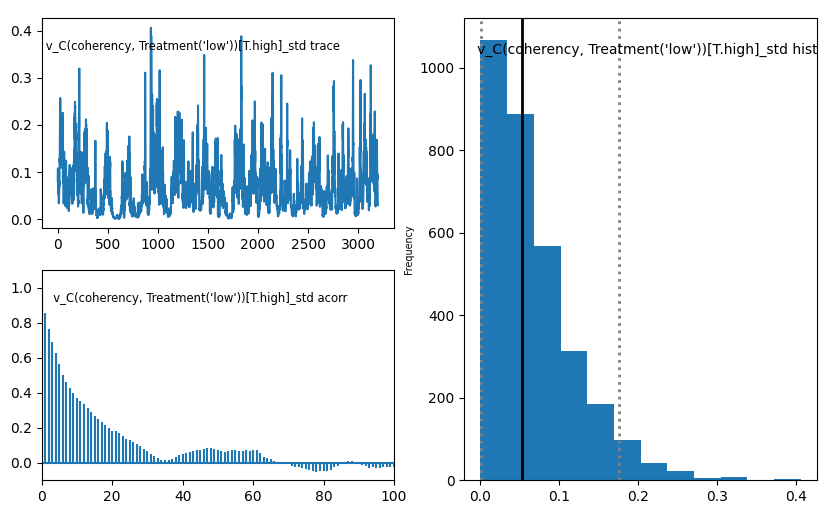

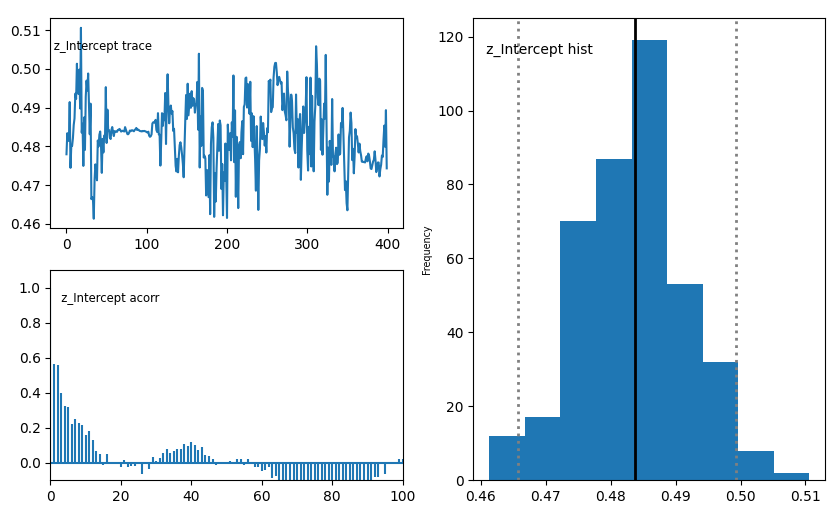

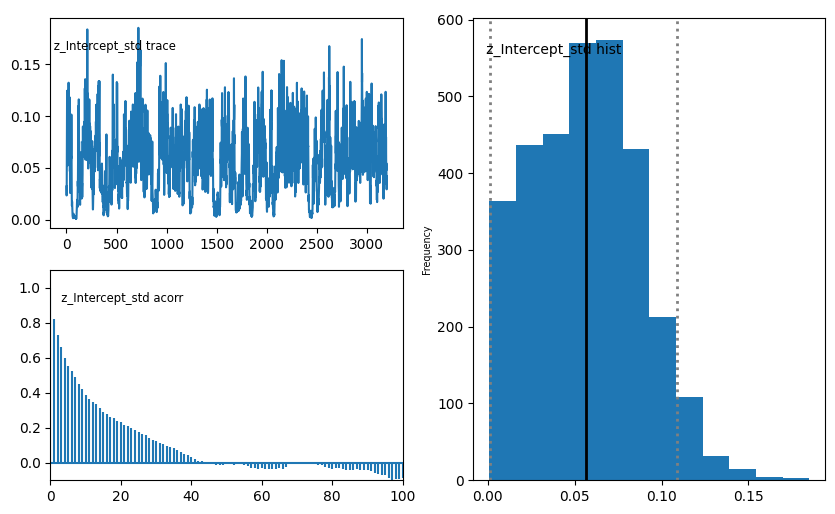

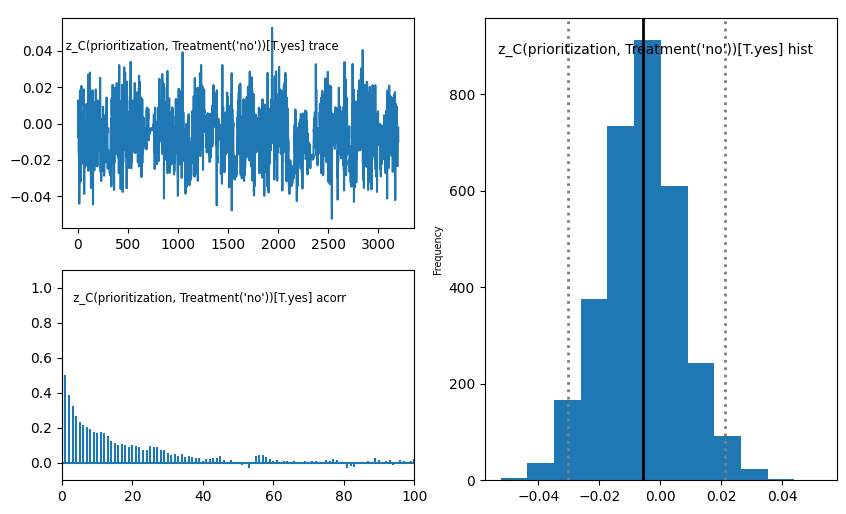

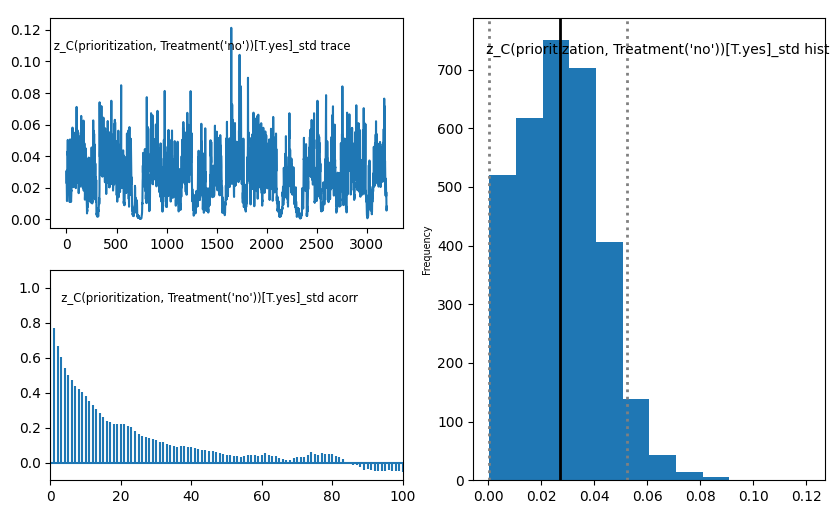

<Figure size 800x600 with 0 Axes>

In [31]:
models_x = []
for model_path in glob(os.path.join(os.getcwd(),'2_4_2_2_temp/mx_chain_*')):
    if ('db' not in model_path) and ('csv' not in model_path):
        modelx = hddm.load(model_path)
        models_x.append(modelx)
        

print(gelman_rubin(models_x))

mx = kabuki.utils.concat_models(models_x)

mx.plot_posteriors()

mx.plot_posterior_predictive()


In [27]:

print(mx.dic)

1805.0608188020262


In [8]:
models_x

[]

In [28]:
mxdf = mx.get_traces()

In [29]:
mxdf['z_Intercept_trans']

0      -0.088259
1      -0.066460
2      -0.072980
3      -0.074588
4      -0.034272
          ...   
3195   -0.032777
3196   -0.042898
3197   -0.037686
3198   -0.069301
3199   -0.054598
Name: z_Intercept_trans, Length: 3200, dtype: float64

In [32]:


# m: HDDMRegressor: v ~ 1 + C(coherency, Treatment('low')), t ~ 1 + C(prioritization, Treatment('no')), with ['z','st','sv','sz']
def run_m5_x(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    
    v_reg={'model': "v~1+C(coherency, Treatment('low'))", 'link_func': lambda x:x}
    
    t_reg={'model': "t~1+C(prioritization, Treatment('no'))", 'link_func': lambda x:x}

    m = hddm.HDDMRegressor(df, [v_reg, t_reg] ,include=['z'],keep_regressor_trace=True, group_only_regressors = False)
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m5_x = Parallel(n_jobs = 8)(delayed(run_m5_x)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m5_x' ) for i in range(8))

Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['t_Intercept', "t_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['t_Intercept', "t_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['t_Intercept', "t_C(prioritization, Treatment('no'))[T.yes]"]
Adding these covariates:
['v_Intercept', "v_C(coherency, Treatment('low'))[T.high]"]
Adding these covariates:
['t_Intercept', "t_C(prioritiza

/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/site-packages/scipy/optimize/optimize.py:2116: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/yikang1020/anaconda3/envs/hddm38/lib/python3.8/si

[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 3 of 4000 complete in 1.2 sec
[                  0%                  ] 2 of 4000 complete in 0.5 sec
[                  0%                  ] 2 of 4000 complete in 0.6 sec
[                  0%                  ] 3 of 4000 complete in 0.9 sec
[                  0%                  ] 3 of 4000 complete in 1.0 sec
[                  0%                  ] 3 of 4000 complete in 0.8 sec
[                  0%                  ] 2 of 4000 complete in 0.7 sec
[                  0%                  ] 4 of 4000 complete in 1.7 sec
[                  0%                  ] 2 of 4000 complete in 0.5 sec
[                  0%                  ] 4 of 4000 complete in 1.4 sec
[                  0%                  ] 4 of 4000 complete in 1.7 sec
[                  0%                  ] 5 of 4000 complete in 1.7 sec
[                  0%                  ] 4 of 4000 complete in 1.4 sec
[     

{'a': 0.9999441504958254, 'a_std': 0.9998949673739362, 'a_subj.1': 1.000060196366512, 'a_subj.3': 0.9999690455533303, 'a_subj.5': 1.0132578883963756, 'a_subj.6': 0.999981225622369, 'a_subj.7': 1.0002665814411853, 'a_subj.8': 1.000082780665208, 'a_subj.9': 1.0003977298763453, 'a_subj.10': 1.0002974959812314, 'a_subj.11': 1.0001281459114713, 'a_subj.12': 1.0000281902234691, 'a_subj.13': 1.000457503722488, 'a_subj.14': 1.0000957555209227, 'a_subj.15': 1.0018971949248243, 'a_subj.16': 1.0000021267917198, 'a_subj.17': 1.0007696757899698, 'z_trans': 1.0033683627851162, 'z_std': 1.0026677557341175, 'z_subj_trans.1': 1.0015229576377198, 'z_subj_trans.3': 1.0018650943913963, 'z_subj_trans.5': 1.0050610695154525, 'z_subj_trans.6': 1.001005370800887, 'z_subj_trans.7': 1.0010943693109684, 'z_subj_trans.8': 1.0005187749839264, 'z_subj_trans.9': 1.0008955311810896, 'z_subj_trans.10': 1.0010012461908584, 'z_subj_trans.11': 1.0003011386194822, 'z_subj_trans.12': 1.0015953581123986, 'z_subj_trans.13': 

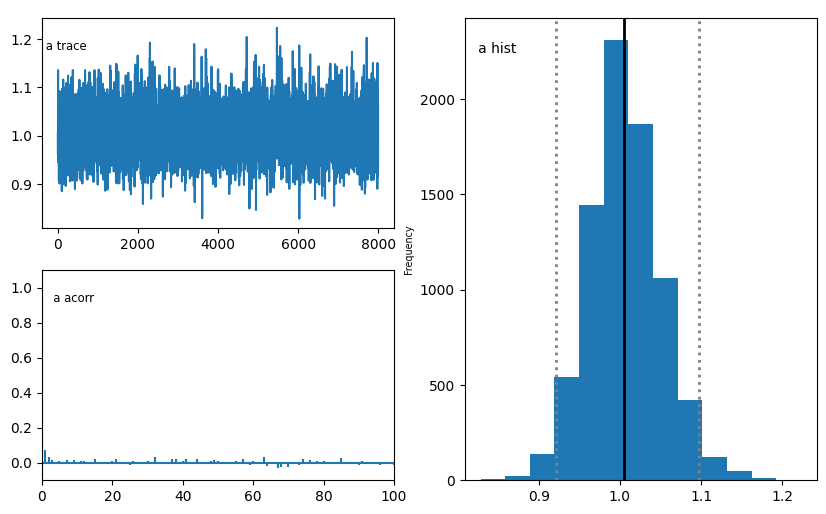

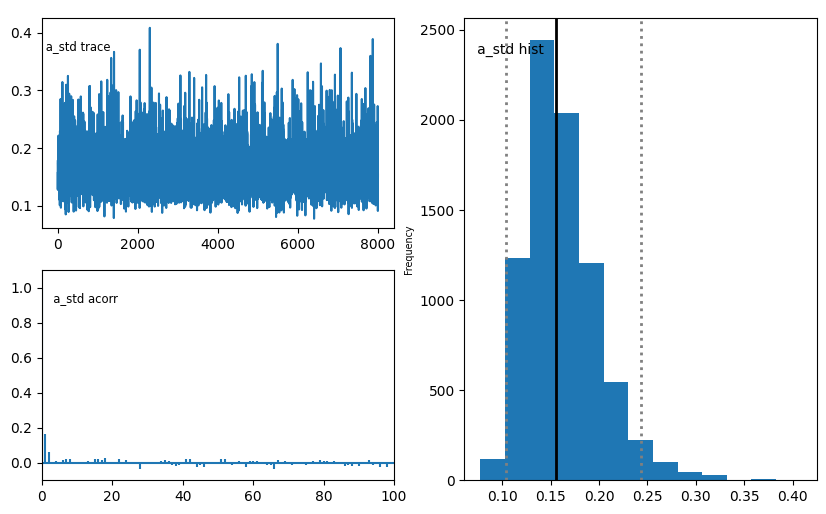

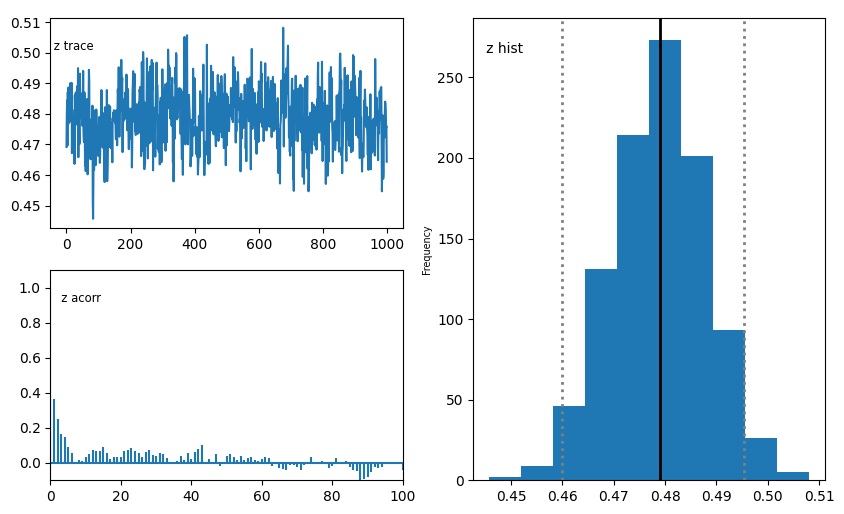

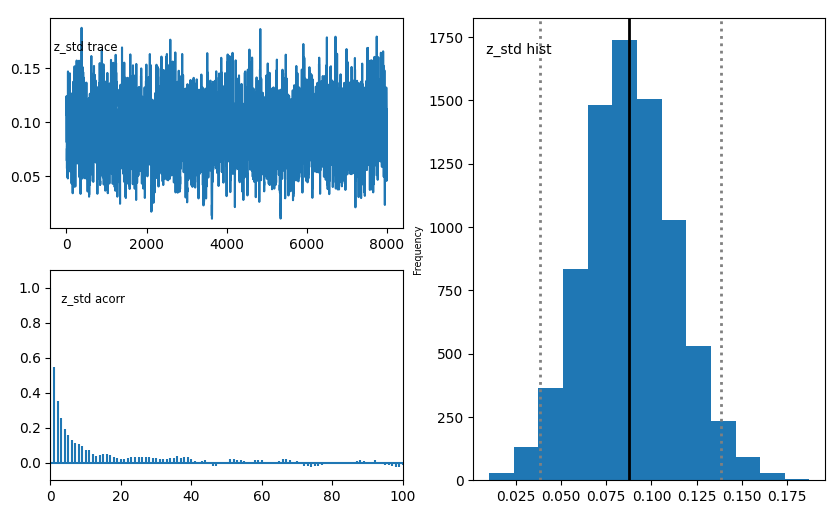

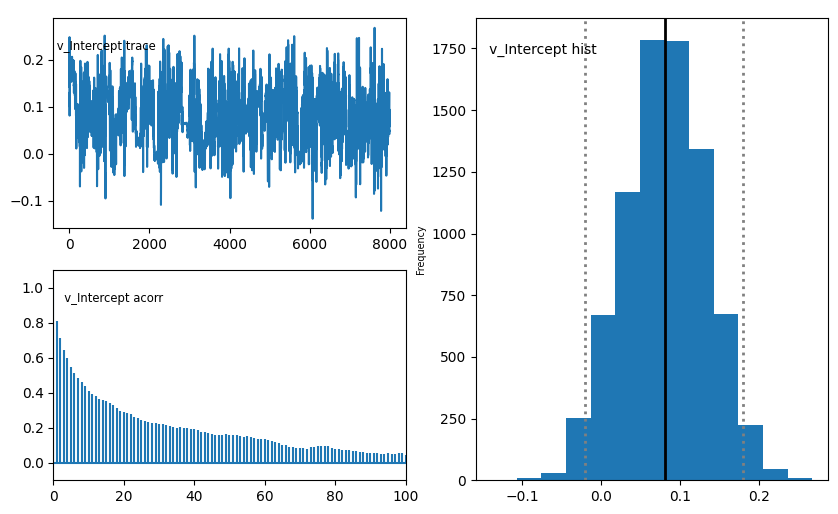

...

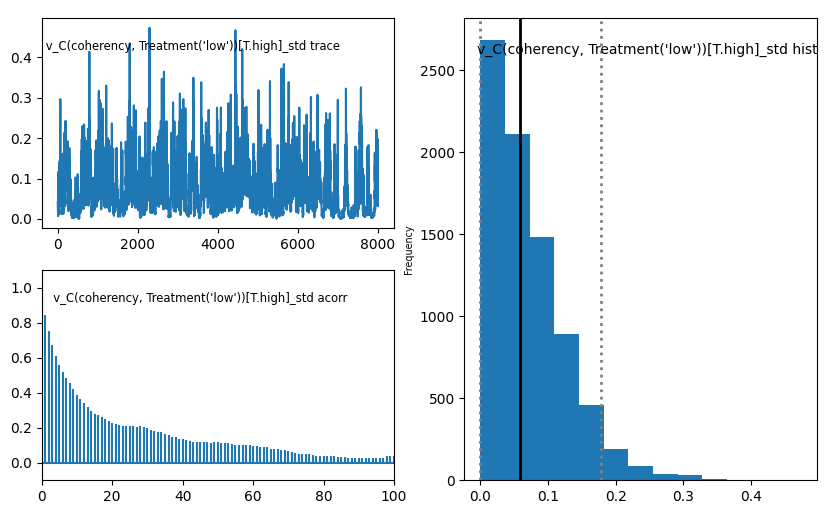

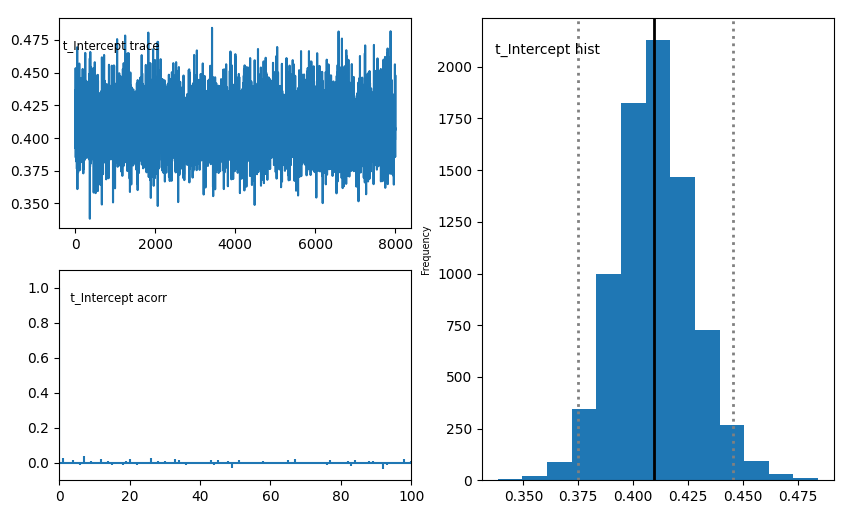

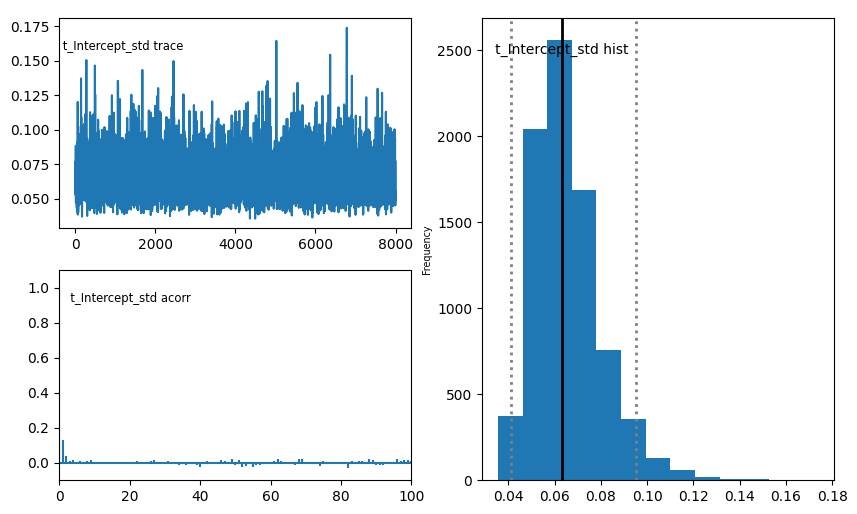

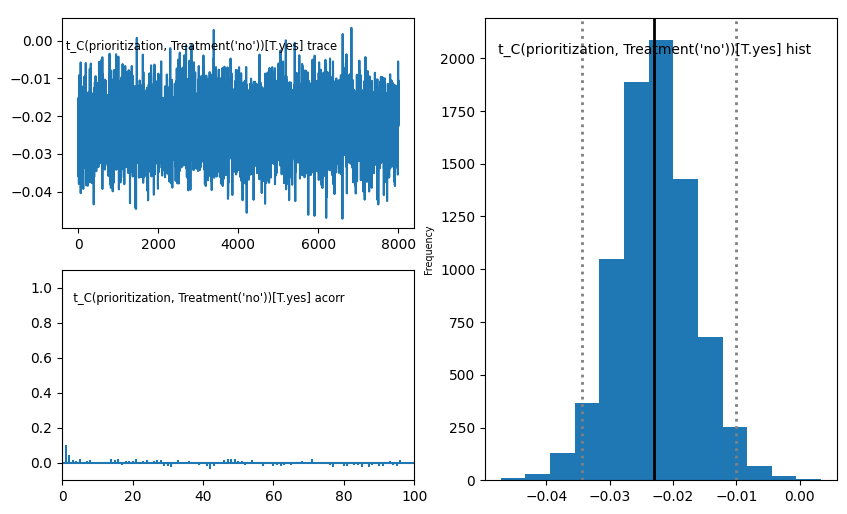

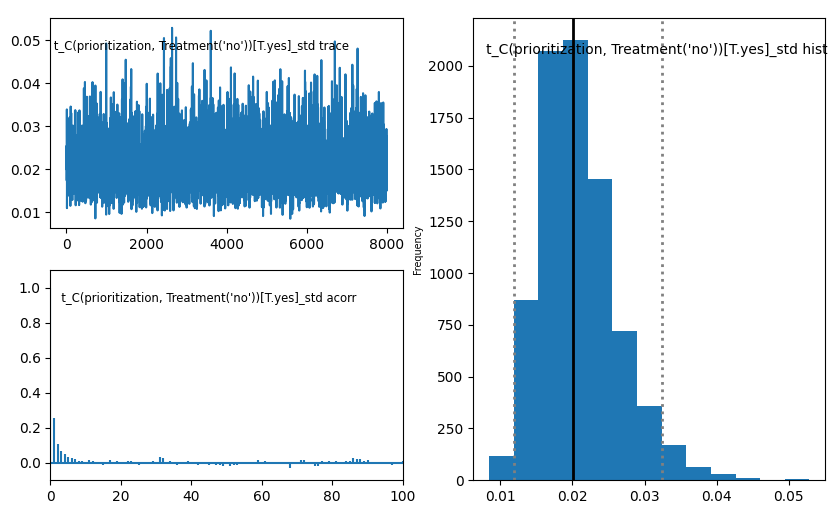

<Figure size 800x600 with 0 Axes>

In [35]:
models_x = []
for model_path in glob(os.path.join(os.getcwd(),'2_4_2_2_temp/m5_x_chain_*')):
    if ('db' not in model_path) and ('csv' not in model_path):
        modelx = hddm.load(model_path)
        models_x.append(modelx)
        

print(gelman_rubin(models_x))

mx = kabuki.utils.concat_models(models_x)

mx.plot_posteriors()

mx.plot_posterior_predictive()

In [36]:
print(mx.dic)

1665.9769581453634


In [ ]:


# m: HDDMRegressor: v ~ 1 + C(coherency, Treatment('low')), t ~ 1 + C(prioritization, Treatment('no')), with ['z','st','sv','sz']
def run_m5_x(id, df=None, samples=None, burn=None,thin=1, save_name=None): 
    
    dbname = save_name + '_chain_%i.db'%id 

    mname  = save_name + '_chain_%i'%id    
   
    
    v_reg={'model': "v~1+C(coherency, Treatment('low'))", 'link_func': lambda x:x}
    
    t_reg={'model': "t~1+C(prioritization, Treatment('no'))", 'link_func': lambda x:x}

    m = hddm.HDDMRegressor(df, [v_reg, t_reg] ,include=['z','sz'],keep_regressor_trace=True, group_only_regressors = False)
    
    m.find_starting_values()
    
    m.sample(samples, burn=burn, dbname=dbname, thin=thin,db='pickle') 
    
    m.save(mname)
    
    return m

m5_x = Parallel(n_jobs = 8)(delayed(run_m5_x)(id = i, df = df, samples=4000,burn = 2000,thin=2, save_name = '2_4_2_2_temp/m5_x' ) for i in range(8))